<a href="https://colab.research.google.com/github/jamieth0405/DAT490-Data-Science-Capstone/blob/main/Vanya_Data_Science_Capstone_TEST_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Basic setup
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from google.colab import files

# Optional: ensure figures show inline
%matplotlib inline

plt.rcParams["figure.figsize"] = (8, 6)

# Upload CSV files (AAPL.csv, AMD.csv, etc.)
uploaded = files.upload()

# Check which files were uploaded
print("\nUploaded files:")
for fn in uploaded.keys():
    print(" -", fn)

Saving AAPL.csv to AAPL.csv
Saving AMD.csv to AMD.csv
Saving CSCO.csv to CSCO.csv
Saving EMR.csv to EMR.csv
Saving GE.csv to GE.csv
Saving HON.csv to HON.csv
Saving IBM.csv to IBM.csv
Saving MSFT.csv to MSFT.csv
Saving NVDA.csv to NVDA.csv
Saving TXN.csv to TXN.csv
Saving UPS.csv to UPS.csv

Uploaded files:
 - AAPL.csv
 - AMD.csv
 - CSCO.csv
 - EMR.csv
 - GE.csv
 - HON.csv
 - IBM.csv
 - MSFT.csv
 - NVDA.csv
 - TXN.csv
 - UPS.csv


In [2]:
import io

def compute_rsi(series, period=14):
    delta = series.diff()
    gain = delta.clip(lower=0)
    loss = -delta.clip(upper=0)
    avg_gain = gain.rolling(window=period, min_periods=period).mean()
    avg_loss = loss.rolling(window=period, min_periods=period).mean()
    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    return rsi

frames = []

for filename in uploaded.keys():
    ticker = filename.split(".")[0].upper()
    df = pd.read_csv(io.BytesIO(uploaded[filename]))
    df.columns = [c.strip().title() for c in df.columns]
    df["Date"] = pd.to_datetime(df["Date"], errors="coerce", dayfirst=True)
    df = df.sort_values("Date")

    # Handle missing data and numeric types
    for col in ["Open","High","Low","Close","Adjusted Close","Volume"]:
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.ffill()

    # Feature engineering
    df["Return"] = df["Close"].pct_change()
    df["LogReturn"] = np.log(df["Close"] / df["Close"].shift(1))
    df["MA7"] = df["Close"].rolling(7).mean()
    df["MA30"] = df["Close"].rolling(30).mean()
    df["Volatility20"] = df["Return"].rolling(20).std()
    df["RSI14"] = compute_rsi(df["Close"], 14)
    df["Ticker"] = ticker
    frames.append(df)

data = pd.concat(frames, ignore_index=True)
print("Loaded tickers:", data["Ticker"].unique())
data.head()

Loaded tickers: ['AAPL' 'AMD' 'CSCO' 'EMR' 'GE' 'HON' 'IBM' 'MSFT' 'NVDA' 'TXN' 'UPS']


,Date,Low,Open,Volume,High,Close,Adjusted Close,Return,LogReturn,MA7,MA30,Volatility20,RSI14,Ticker
0,1980-12-12,0.128348,0.128348,469033600,0.128906,0.128348,0.099874,NaN,NaN,NaN,NaN,NaN,NaN,AAPL
1,1980-12-15,0.121652,0.122210,175884800,0.122210,0.121652,0.094663,-0.052171,-0.053581,NaN,NaN,NaN,NaN,AAPL
2,1980-12-16,0.112723,0.113281,105728000,0.113281,0.112723,0.087715,-0.073398,-0.076231,NaN,NaN,NaN,NaN,AAPL
3,1980-12-17,0.115513,0.115513,86441600,0.116071,0.115513,0.089886,0.024751,0.024450,NaN,NaN,NaN,NaN,AAPL
4,1980-12-18,0.118862,0.118862,73449600,0.119420,0.118862,0.092492,0.028992,0.028580,NaN,NaN,NaN,NaN,AAPL


In [3]:
data.info()
data.describe()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 116280 entries, 0 to 116279
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Date            116280 non-null  datetime64[ns]
 1   Low             116280 non-null  float64       
 2   Open            116280 non-null  float64       
 3   Volume          116280 non-null  int64         
 4   High            116280 non-null  float64       
 5   Close           116280 non-null  float64       
 6   Adjusted Close  116280 non-null  float64       
 7   Return          116269 non-null  float64       
 8   LogReturn       116269 non-null  float64       
 9   MA7             116214 non-null  float64       
 10  MA30            115961 non-null  float64       
 11  Volatility20    116060 non-null  float64       
 12  RSI14           116126 non-null  float64       
 13  Ticker          116280 non-null  object        
dtypes: datetime64[ns](1), float64(11), i

,Date,Low,Open,Volume,High,Close,Adjusted Close,Return,LogReturn,MA7,MA30,Volatility20,RSI14
count,116280,116280.000000,116280.000000,1.162800e+05,116280.000000,116280.000000,116280.000000,116269.000000,116269.000000,116214.000000,115961.000000,116060.000000,116126.000000
mean,2000-07-19 11:21:41.795665536,45.611693,46.103996,4.585259e+07,46.639204,46.135663,34.853561,0.000701,0.000413,46.118643,46.053337,0.020430,52.064527
min,1970-01-02 00:00:00,0.049107,0.000000,0.000000e+00,0.049665,0.049107,0.038213,-0.518692,-0.731248,0.051897,0.056920,0.002462,0.000000
25%,1989-08-25 00:00:00,5.734375,5.791667,1.994400e+06,5.898974,5.819526,2.899901,-0.010077,-0.010128,5.821429,5.845833,0.011973,40.116928
50%,2001-12-13 00:00:00,22.048279,22.347036,5.459642e+06,22.690001,22.375000,14.085711,0.000000,0.000000,22.407589,22.440104,0.016960,52.112674
75%,2012-06-13 00:00:00,57.560001,58.172499,3.469698e+07,58.799999,58.180000,43.792631,0.010914,0.010855,58.064289,58.079487,0.025134,64.210525
max,2022-12-12 00:00:00,457.211548,458.173065,7.421641e+09,465.384613,461.538452,339.924866,0.522901,0.420617,455.700557,450.160260,0.151211,100.000000
std,NaN,61.754582,62.452327,1.386814e+08,63.083384,62.436488,50.004036,0.023987,0.024039,62.403434,62.289933,0.012633,16.746120


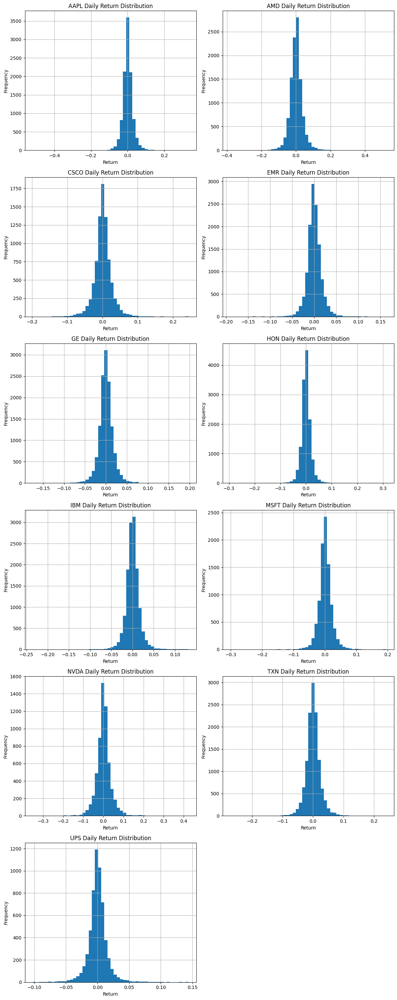

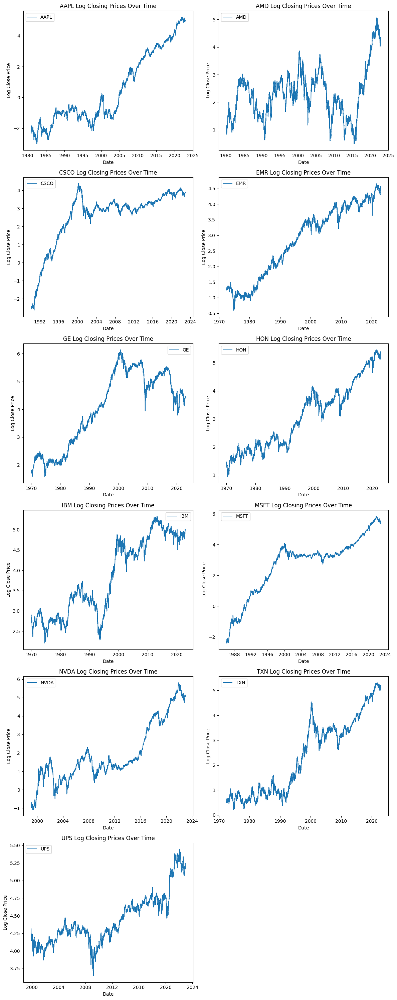

In [4]:
import math

# Histogram of daily returns per ticker
tickers = data["Ticker"].unique()
n_tickers = len(tickers)
n_cols = 2
n_rows = math.ceil(n_tickers / n_cols)

fig_hist, axes_hist = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 5))
axes_hist = axes_hist.flatten()

for i, t in enumerate(tickers):
    subset = data[data["Ticker"]==t]
    subset["Return"].dropna().hist(bins=50, ax=axes_hist[i])
    axes_hist[i].set_title(f"{t} Daily Return Distribution")
    axes_hist[i].set_xlabel("Return")
    axes_hist[i].set_ylabel("Frequency")

# Hide any unused subplots
for j in range(i + 1, len(axes_hist)):
    fig_hist.delaxes(axes_hist[j])

plt.tight_layout()
plt.show()

# Line plot of closing prices (log scale)
fig_log, axes_log = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 5))
axes_log = axes_log.flatten()

for i, t in enumerate(tickers):
    subset = data[data["Ticker"]==t]
    axes_log[i].plot(subset["Date"], np.log(subset["Close"]), label=t)
    axes_log[i].set_title(f"{t} Log Closing Prices Over Time")
    axes_log[i].set_xlabel("Date")
    axes_log[i].set_ylabel("Log Close Price")
    axes_log[i].legend()

# Hide any unused subplots
for j in range(i + 1, len(axes_log)):
    fig_log.delaxes(axes_log[j])

plt.tight_layout()
plt.show()

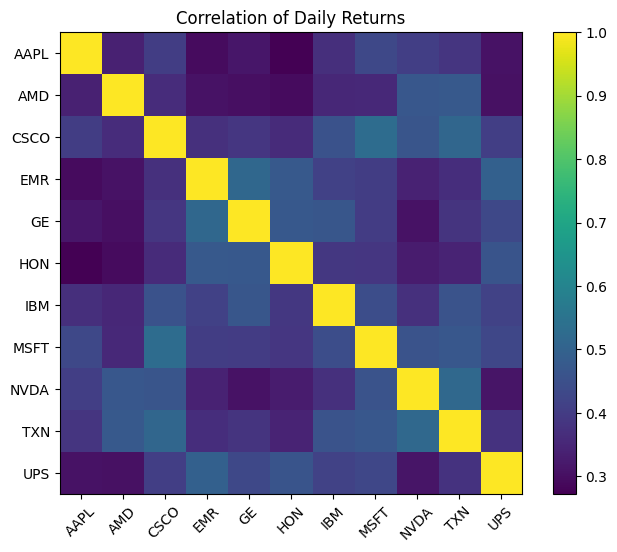

In [5]:
returns_wide = data.pivot(index="Date", columns="Ticker", values="Return")
corr = returns_wide.corr()

plt.imshow(corr, interpolation='nearest')
plt.title("Correlation of Daily Returns")
plt.xticks(range(len(corr.columns)), corr.columns, rotation=45)
plt.yticks(range(len(corr.columns)), corr.columns)
plt.colorbar()
plt.show()

In [6]:
data["Month"] = data["Date"].dt.to_period("M")
monthly_returns = data.groupby(["Ticker","Month"])["Return"].mean().reset_index()
monthly_returns.head()


,Ticker,Month,Return
0,AAPL,1980-12,0.015527
1,AAPL,1981-01,-0.008515
2,AAPL,1981-02,-0.002669
3,AAPL,1981-03,-0.003029
4,AAPL,1981-04,0.007581


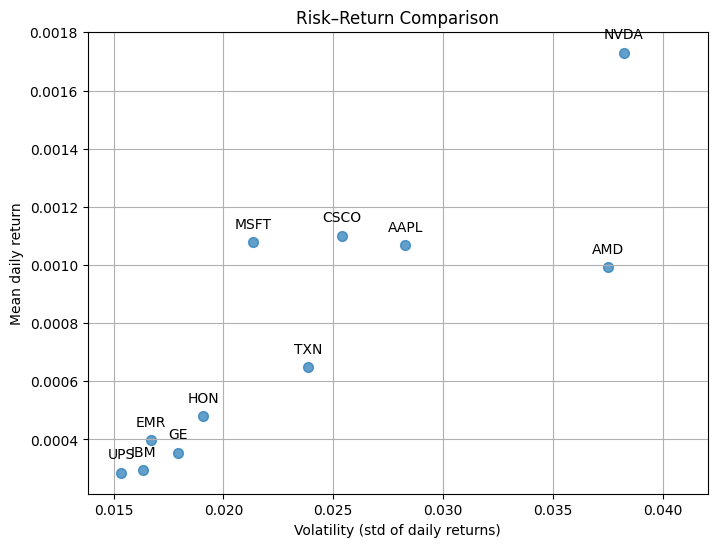

In [7]:
summary = (
    data.groupby("Ticker")["Return"]
    .agg(["mean","std"])
    .rename(columns={"mean":"MeanReturn","std":"Volatility"})
)
plt.scatter(summary["Volatility"], summary["MeanReturn"], alpha=0.7, s=50) # Adjust marker size and transparency
for t in summary.index:
    plt.annotate(t, (summary.loc[t,"Volatility"], summary.loc[t,"MeanReturn"]), textcoords="offset points", xytext=(0,10), ha='center') # Improve annotations
plt.title("Risk–Return Comparison")
plt.xlabel("Volatility (std of daily returns)")
plt.ylabel("Mean daily return")
plt.grid(True) # Add grid
plt.xlim(summary["Volatility"].min() * 0.9, summary["Volatility"].max() * 1.1) # Add padding to x-axis
plt.show()

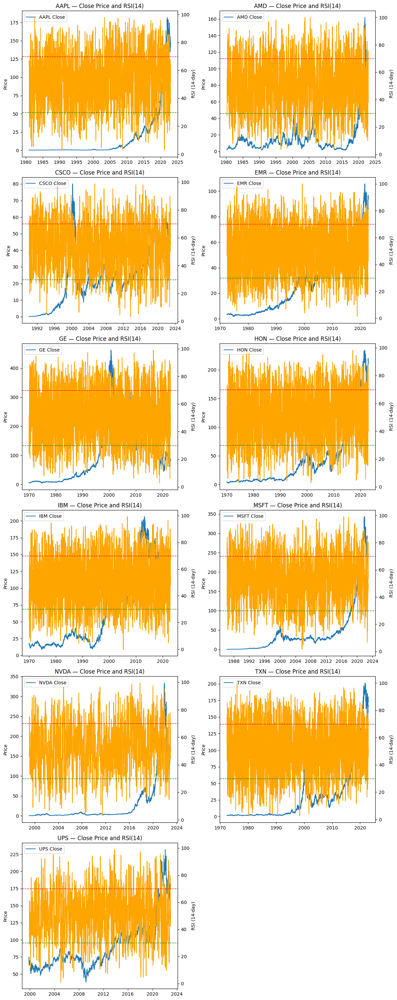

In [8]:
import math

# --- RSI function ---
def compute_rsi(series, period: int = 14):
    delta = series.diff()
    gain = delta.clip(lower=0)
    loss = -delta.clip(upper=0)
    avg_gain = gain.rolling(window=period, min_periods=period).mean()
    avg_loss = loss.rolling(window=period, min_periods=period).mean()
    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    return rsi

# --- Apply RSI to each ticker ---
data["RSI14"] = data.groupby("Ticker")["Close"].transform(lambda x: compute_rsi(x, 14))

# --- Example plot ---
tickers = data["Ticker"].unique()
n_tickers = len(tickers)
n_cols = 2
n_rows = math.ceil(n_tickers / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 5))
axes = axes.flatten()

for i, ticker in enumerate(tickers):
    sub = data[data["Ticker"] == ticker]

    ax1 = axes[i]
    ax2 = ax1.twinx()

    ax1.plot(sub["Date"], sub["Close"], label=f"{ticker} Close")
    ax1.set_ylabel("Price")

    ax2.plot(sub["Date"], sub["RSI14"], color="orange", label="RSI14")
    ax2.axhline(70, color="red", linestyle="--", linewidth=1)
    ax2.axhline(30, color="green", linestyle="--", linewidth=1)
    ax2.set_ylabel("RSI (14-day)")
    axes[i].set_title(f"{ticker} — Close Price and RSI(14)")
    axes[i].legend(loc="upper left")

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

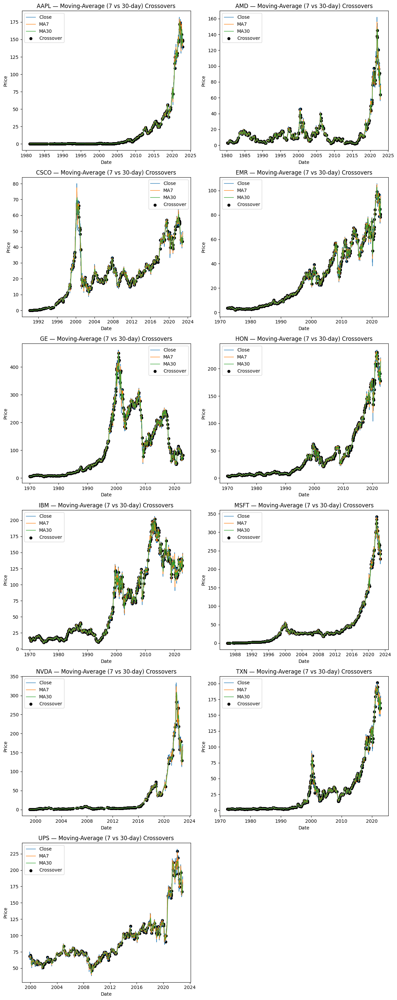

In [9]:
import math

# --- Example for one ticker ---
tickers = data["Ticker"].unique()
n_tickers = len(tickers)
n_cols = 2
n_rows = math.ceil(n_tickers / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 5))
axes = axes.flatten()

for i, ticker in enumerate(tickers):
    sub = data[data["Ticker"] == ticker].copy()

    # Identify crossover points
    sub["MA7_above_MA30"] = sub["MA7"] > sub["MA30"]
    sub["Crossover"] = sub["MA7_above_MA30"].ne(sub["MA7_above_MA30"].shift(1))

    # Plot with crossover markers
    axes[i].plot(sub["Date"], sub["Close"], label="Close", linewidth=1)
    axes[i].plot(sub["Date"], sub["MA7"], label="MA7", linewidth=1)
    axes[i].plot(sub["Date"], sub["MA30"], label="MA30", linewidth=1)

    # Mark crossover points
    cross_points = sub[sub["Crossover"]]
    axes[i].scatter(cross_points["Date"], cross_points["Close"], color="black", marker="o", s=30, label="Crossover")

    axes[i].set_title(f"{ticker} — Moving-Average (7 vs 30-day) Crossovers")
    axes[i].set_xlabel("Date")
    axes[i].set_ylabel("Price")
    axes[i].legend()

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

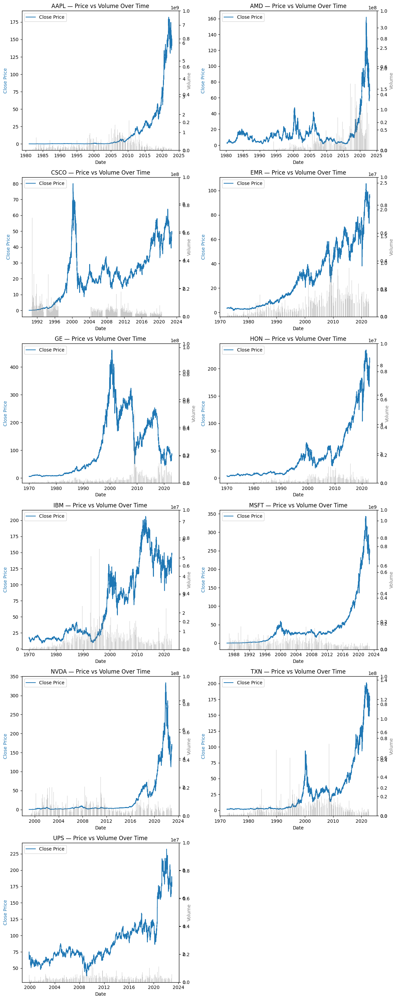

In [10]:
import math

# ======================================
# Plot Close Price and Volume for each ticker
# ======================================
tickers = sorted(data["Ticker"].unique())
n_tickers = len(tickers)
n_cols = 2
n_rows = math.ceil(n_tickers / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 5))
axes = axes.flatten()

for i, ticker in enumerate(tickers):
    sub = data[data["Ticker"] == ticker]

    # Skip empty datasets
    if sub.empty:
        continue

    # Create dual-axis chart
    ax1 = axes[i]
    ax2 = ax1.twinx()

    # Left y-axis → Close Price
    ax1.plot(sub["Date"], sub["Close"], color="tab:blue", label="Close Price")
    ax1.set_xlabel("Date")
    ax1.set_ylabel("Close Price", color="tab:blue")

    # Right y-axis → Volume
    ax2 = ax1.twinx()
    ax2.bar(sub["Date"], sub["Volume"], color="tab:gray", alpha=0.4, label="Volume")
    ax2.set_ylabel("Volume", color="tab:gray")

    # Title + legend
    axes[i].set_title(f"{ticker} — Price vs Volume Over Time", fontsize=12)
    axes[i].legend(loc="upper left")

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


Average next-day return by RSI zone for AAPL:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0012
30-50,-0.0000
50-70,0.0018
>70,0.0015



Average next-day return by RSI zone for AMD:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0006
30-50,0.0005
50-70,0.0014
>70,0.0016



Average next-day return by RSI zone for CSCO:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0037
30-50,0.0009
50-70,0.0011
>70,0.0003



Average next-day return by RSI zone for EMR:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0012
30-50,0.0006
50-70,0.0004
>70,-0.0005



Average next-day return by RSI zone for GE:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0014
30-50,-0.0001
50-70,0.0005
>70,0.0003



Average next-day return by RSI zone for HON:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0014
30-50,0.0005
50-70,0.0004
>70,0.0002


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)



Average next-day return by RSI zone for IBM:


,NextReturn
RSI_Bin,
<30,0.0006
30-50,0.0001
50-70,0.0003
>70,0.0008



Average next-day return by RSI zone for MSFT:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0038
30-50,0.0008
50-70,0.0007
>70,0.0012



Average next-day return by RSI zone for NVDA:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0027
30-50,0.0009
50-70,0.0019
>70,0.0024



Average next-day return by RSI zone for TXN:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,0.0017
30-50,0.0005
50-70,0.0003
>70,0.0011



Average next-day return by RSI zone for UPS:


/tmp/ipython-input-1425309382.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)


,NextReturn
RSI_Bin,
<30,-0.0000
30-50,0.0005
50-70,0.0001
>70,0.0006


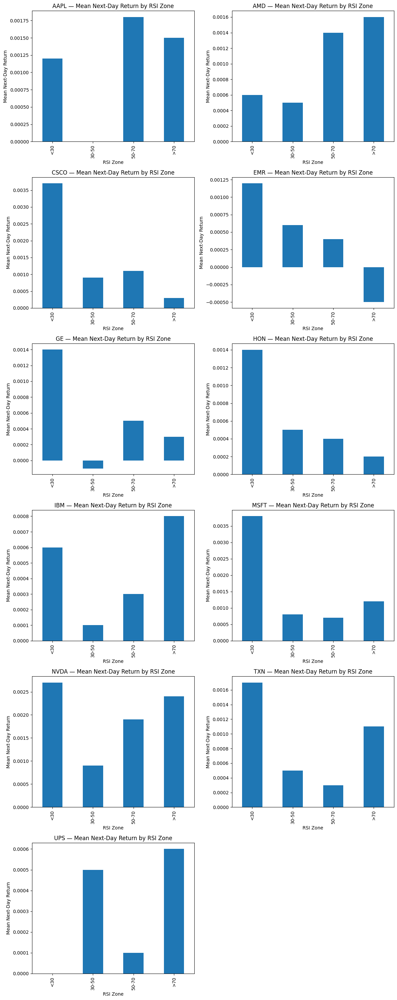

In [11]:
import math

# Simple mean-reversion test for one ticker
tickers = data["Ticker"].unique()
n_tickers = len(tickers)
n_cols = 2
n_rows = math.ceil(n_tickers / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 5))
axes = axes.flatten()

for i, ticker in enumerate(tickers):
    sub = data[data["Ticker"] == ticker].copy()
    sub["NextReturn"] = sub["Return"].shift(-1)

    # Bin RSI into zones
    bins = [0,30,50,70,100]
    labels = ["<30","30-50","50-70",">70"]
    sub["RSI_Bin"] = pd.cut(sub["RSI14"], bins=bins, labels=labels, include_lowest=True)

    # Average next-day return per RSI bin
    rsi_perf = sub.groupby("RSI_Bin")["NextReturn"].mean().round(4)
    print(f"\nAverage next-day return by RSI zone for {ticker}:")
    display(rsi_perf)

    rsi_perf.plot(kind="bar", ax=axes[i], title=f"{ticker} — Mean Next-Day Return by RSI Zone") # Specify ax
    axes[i].set_ylabel("Mean Next-Day Return")
    axes[i].set_xlabel("RSI Zone")

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [12]:
!pip install plotly
import plotly.graph_objects as go


In [13]:
# Rolling windows you want to overlay (same as Kaggle example)
rolling_windows = [20, 50, 200]

for ticker in sorted(data["Ticker"].unique()):
    sub = data[data["Ticker"] == ticker].copy()
    if sub.empty:
        continue

    # Compute rolling averages if not already present
    for w in rolling_windows:
        sub[f"MA{w}"] = sub["Close"].rolling(window=w).mean()

    # Optional: focus on modern years
    # sub = sub[sub["Date"] >= "2015-01-01"]

    # --- Candlestick figure ---
    fig = go.Figure()

    fig.add_trace(go.Candlestick(
        x=sub["Date"],
        open=sub["Open"],
        high=sub["High"],
        low=sub["Low"],
        close=sub["Close"],
        name=f"{ticker} Price",
        increasing_line_color='green',
        decreasing_line_color='red'
    ))

    # --- Add moving averages ---
    for w in rolling_windows:
        fig.add_trace(go.Scatter(
            x=sub["Date"],
            y=sub[f"MA{w}"],
            mode='lines',
            name=f"MA{w}",
            line=dict(width=1.5)
        ))

    # --- Layout customization ---
    fig.update_layout(
        title=f"{ticker} — Candlestick with 20/50/200-Day MAs",
        xaxis_title="Date",
        yaxis_title="Price",
        xaxis_rangeslider_visible=False,
        template="plotly_dark",     # Use dark theme like Kaggle example
        height=600,
        width=1000,
        legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
    )

    fig.show()

#Extended EDA

## Visual Checking Stationarity

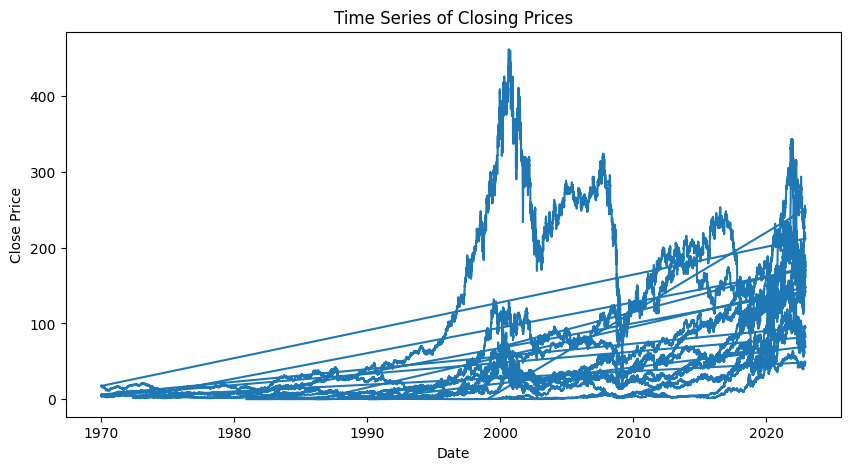

In [14]:
plt.figure(figsize=(10,5))
plt.plot(data["Date"], data["Close"])
plt.title("Time Series of Closing Prices")
plt.xlabel("Date")
plt.ylabel("Close Price")
plt.show()


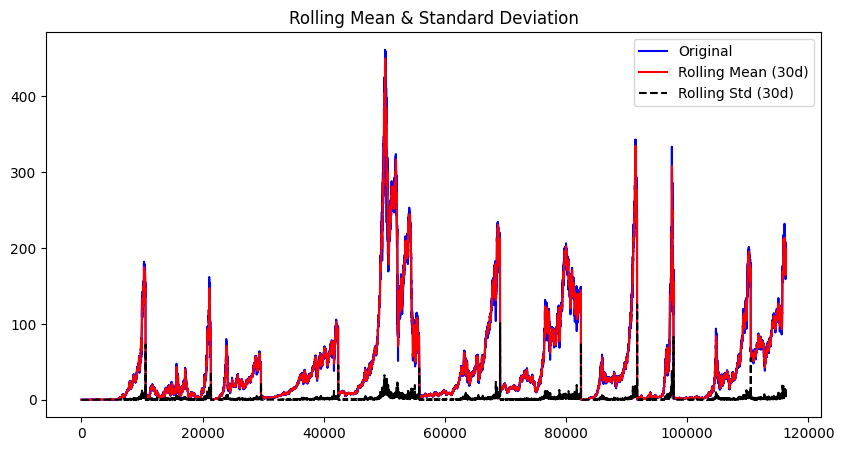

In [15]:
rolling_mean = data["Close"].rolling(window=30).mean()
rolling_std = data["Close"].rolling(window=30).std()

plt.figure(figsize=(10,5))
plt.plot(data["Close"], label='Original', color='blue')
plt.plot(rolling_mean, label='Rolling Mean (30d)', color='red')
plt.plot(rolling_std, label='Rolling Std (30d)', color='black', linestyle='--')
plt.title("Rolling Mean & Standard Deviation")
plt.legend()
plt.show()


##Statistical Tests for Stationarity

In [16]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(data["Close"].dropna())
print("ADF Statistic:", result[0])
print("p-value:", result[1])
for key, value in result[4].items():
    print('Critical Value (%s): %.3f' % (key, value))

if result[1] < 0.05:
    print("✅ Stationary (reject H₀)")
else:
    print("⚠️ Non-stationary (fail to reject H₀)")


ADF Statistic: -4.575107184304345
p-value: 0.00014352610251783756
Critical Value (1%): -3.430
Critical Value (5%): -2.862
Critical Value (10%): -2.567
✅ Stationary (reject H₀)


Augmented Dickey-Fuller (ADF) Test:

Null hypothesis (H₀): data is non-stationary (has a unit root).
If the p-value < 0.05, reject H₀ → data is stationary.

Null hypothesis (H₀): data is stationary.
If the p-value < 0.05, reject H₀ → data is non-stationary.

In [17]:
from statsmodels.tsa.stattools import kpss

stat, p_value, lags, crit = kpss(data["Close"].dropna(), regression='c', nlags='auto')
print(f"KPSS Statistic: {stat:.3f}")
print(f"p-value: {p_value:.3f}")

if p_value < 0.05:
    print("⚠️ Non-stationary (reject H₀)")
else:
    print("✅ Stationary (fail to reject H₀)")


KPSS Statistic: 3.797
p-value: 0.010
⚠️ Non-stationary (reject H₀)


/tmp/ipython-input-1606978797.py:3: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




##Differencing

In [18]:
data["Close_diff1"] = data["Close"].diff()


ARIMA Model

Linear Regression

In [19]:
# Select one ticker to analyze (AAPL, AMD, TSLA, etc.)
ticker = "AAPL"

# Filter your main dataset for that ticker
stock_df = data[data["Ticker"] == ticker].dropna(subset=["Close"]).copy()
stock_df = stock_df.sort_values("Date")

print(f"\nAnalyzing {ticker} data from {stock_df['Date'].min().date()} to {stock_df['Date'].max().date()}")
stock_df.head()



Analyzing AAPL data from 1980-12-12 to 2022-12-12


,Date,Low,Open,Volume,High,Close,Adjusted Close,Return,LogReturn,MA7,MA30,Volatility20,RSI14,Ticker,Month,Close_diff1
0,1980-12-12,0.128348,0.128348,469033600,0.128906,0.128348,0.099874,NaN,NaN,NaN,NaN,NaN,NaN,AAPL,1980-12,NaN
1,1980-12-15,0.121652,0.122210,175884800,0.122210,0.121652,0.094663,-0.052171,-0.053581,NaN,NaN,NaN,NaN,AAPL,1980-12,-0.006696
2,1980-12-16,0.112723,0.113281,105728000,0.113281,0.112723,0.087715,-0.073398,-0.076231,NaN,NaN,NaN,NaN,AAPL,1980-12,-0.008929
3,1980-12-17,0.115513,0.115513,86441600,0.116071,0.115513,0.089886,0.024751,0.024450,NaN,NaN,NaN,NaN,AAPL,1980-12,0.002790
4,1980-12-18,0.118862,0.118862,73449600,0.119420,0.118862,0.092492,0.028992,0.028580,NaN,NaN,NaN,NaN,AAPL,1980-12,0.003349


In [20]:
print("Rows before drop:", len(stock_df))
stock_df["Lag1"] = stock_df["Close"].shift(1)
stock_df["Lag2"] = stock_df["Close"].shift(2)
stock_df = stock_df.dropna(subset=["Lag1","Lag2"])
print("Rows after drop:", len(stock_df))
stock_df.head()


Rows before drop: 10590
Rows after drop: 10588


,Date,Low,Open,Volume,High,Close,Adjusted Close,Return,LogReturn,MA7,MA30,Volatility20,RSI14,Ticker,Month,Close_diff1,Lag1,Lag2
2,1980-12-16,0.112723,0.113281,105728000,0.113281,0.112723,0.087715,-0.073398,-0.076231,NaN,NaN,NaN,NaN,AAPL,1980-12,-0.008929,0.121652,0.128348
3,1980-12-17,0.115513,0.115513,86441600,0.116071,0.115513,0.089886,0.024751,0.024450,NaN,NaN,NaN,NaN,AAPL,1980-12,0.002790,0.112723,0.121652
4,1980-12-18,0.118862,0.118862,73449600,0.119420,0.118862,0.092492,0.028992,0.028580,NaN,NaN,NaN,NaN,AAPL,1980-12,0.003349,0.115513,0.112723
5,1980-12-19,0.126116,0.126116,48630400,0.126674,0.126116,0.098137,0.061029,0.059239,NaN,NaN,NaN,NaN,AAPL,1980-12,0.007254,0.118862,0.115513
6,1980-12-22,0.132254,0.132254,37363200,0.132813,0.132254,0.102913,0.048670,0.047522,0.12221,NaN,NaN,NaN,AAPL,1980-12,0.006138,0.126116,0.118862


In [21]:
print(type(data))
print("Shape:", data.shape)
print(data.columns)
print(data["Ticker"].unique())


<class 'pandas.core.frame.DataFrame'>
Shape: (116280, 16)
Index(['Date', 'Low', 'Open', 'Volume', 'High', 'Close', 'Adjusted Close',
       'Return', 'LogReturn', 'MA7', 'MA30', 'Volatility20', 'RSI14', 'Ticker',
       'Month', 'Close_diff1'],
      dtype='object')
['AAPL' 'AMD' 'CSCO' 'EMR' 'GE' 'HON' 'IBM' 'MSFT' 'NVDA' 'TXN' 'UPS']


   R²: 0.9987
   MAE: 0.9937

Confusion Matrix:
[[   0 1006]
 [   0 1112]]

Classification Report:
              precision    recall  f1-score   support

           0      0.000     0.000     0.000      1006
           1      0.525     1.000     0.689      1112

    accuracy                          0.525      2118
   macro avg      0.263     0.500     0.344      2118
weighted avg      0.276     0.525     0.362      2118



/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



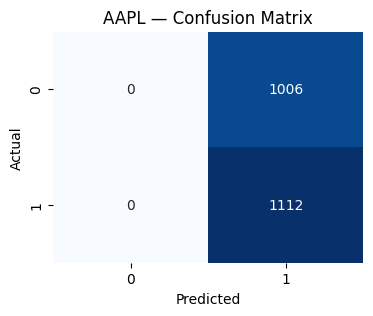


📊 AAPL Results:
   Linear RMSE: 1.7229
   Logistic Accuracy: 0.5250
   R²: 0.9977
   MAE: 0.9653

Confusion Matrix:
[[746 327]
 [784 299]]

Classification Report:
              precision    recall  f1-score   support

           0      0.488     0.695     0.573      1073
           1      0.478     0.276     0.350      1083

    accuracy                          0.485      2156
   macro avg      0.483     0.486     0.462      2156
weighted avg      0.483     0.485     0.461      2156



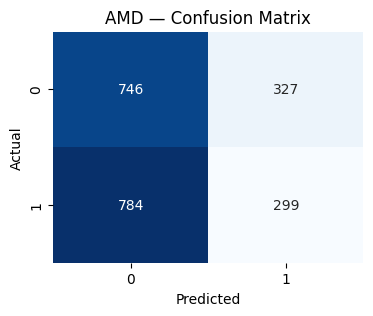


📊 AMD Results:
   Linear RMSE: 1.8558
   Logistic Accuracy: 0.4847
   R²: 0.9925
   MAE: 0.4938

Confusion Matrix:
[[654 133]
 [713 154]]

Classification Report:
              precision    recall  f1-score   support

           0      0.478     0.831     0.607       787
           1      0.537     0.178     0.267       867

    accuracy                          0.489      1654
   macro avg      0.508     0.504     0.437      1654
weighted avg      0.509     0.489     0.429      1654



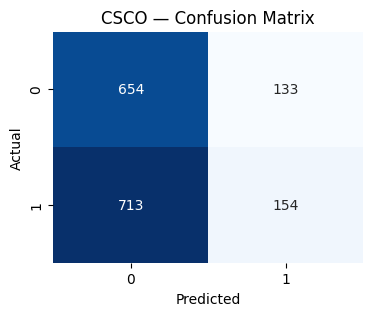


📊 CSCO Results:
   Linear RMSE: 0.7426
   Logistic Accuracy: 0.4885
   R²: 0.9940
   MAE: 0.7505

Confusion Matrix:
[[  94 1122]
 [ 114 1219]]

Classification Report:
              precision    recall  f1-score   support

           0      0.452     0.077     0.132      1216
           1      0.521     0.914     0.664      1333

    accuracy                          0.515      2549
   macro avg      0.486     0.496     0.398      2549
weighted avg      0.488     0.515     0.410      2549



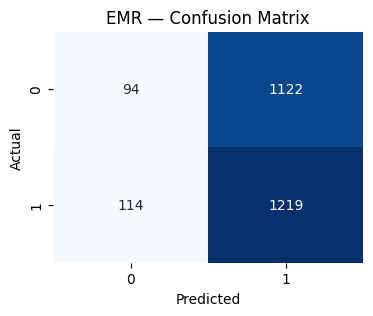


📊 EMR Results:
   Linear RMSE: 1.0814
   Logistic Accuracy: 0.5151
   R²: 0.9987
   MAE: 1.5980

Confusion Matrix:
[[1377    1]
 [1290    3]]

Classification Report:
              precision    recall  f1-score   support

           0      0.516     0.999     0.681      1378
           1      0.750     0.002     0.005      1293

    accuracy                          0.517      2671
   macro avg      0.633     0.501     0.343      2671
weighted avg      0.629     0.517     0.353      2671



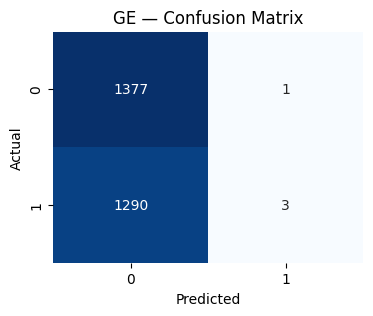


📊 GE Results:
   Linear RMSE: 2.2214
   Logistic Accuracy: 0.5167
   R²: 0.9982
   MAE: 1.2956

Confusion Matrix:
[[   5 1241]
 [  10 1415]]

Classification Report:
              precision    recall  f1-score   support

           0      0.333     0.004     0.008      1246
           1      0.533     0.993     0.693      1425

    accuracy                          0.532      2671
   macro avg      0.433     0.498     0.351      2671
weighted avg      0.440     0.532     0.374      2671



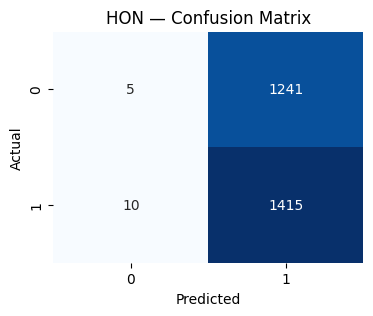


📊 HON Results:
   Linear RMSE: 2.0475
   Logistic Accuracy: 0.5316
   R²: 0.9928
   MAE: 1.3902

Confusion Matrix:
[[  40 1279]
 [  36 1316]]

Classification Report:
              precision    recall  f1-score   support

           0      0.526     0.030     0.057      1319
           1      0.507     0.973     0.667      1352

    accuracy                          0.508      2671
   macro avg      0.517     0.502     0.362      2671
weighted avg      0.517     0.508     0.366      2671



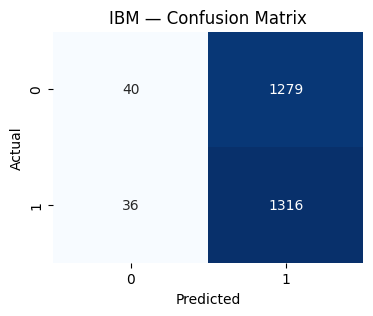


📊 IBM Results:
   Linear RMSE: 2.0199
   Logistic Accuracy: 0.5077
   R²: 0.9986
   MAE: 1.9492

Confusion Matrix:
[[860   0]
 [993   0]]

Classification Report:
              precision    recall  f1-score   support

           0      0.464     1.000     0.634       860
           1      0.000     0.000     0.000       993

    accuracy                          0.464      1853
   macro avg      0.232     0.500     0.317      1853
weighted avg      0.215     0.464     0.294      1853



/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



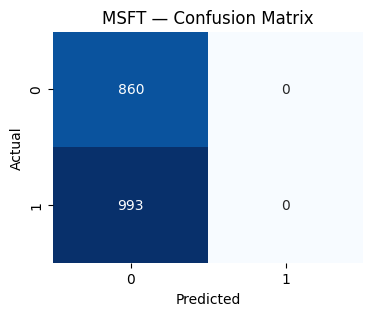


📊 MSFT Results:
   Linear RMSE: 3.2324
   Logistic Accuracy: 0.4641
   R²: 0.9958
   MAE: 2.9560

Confusion Matrix:
[[  1 564]
 [  0 638]]

Classification Report:
              precision    recall  f1-score   support

           0      1.000     0.002     0.004       565
           1      0.531     1.000     0.693       638

    accuracy                          0.531      1203
   macro avg      0.765     0.501     0.349      1203
weighted avg      0.751     0.531     0.369      1203



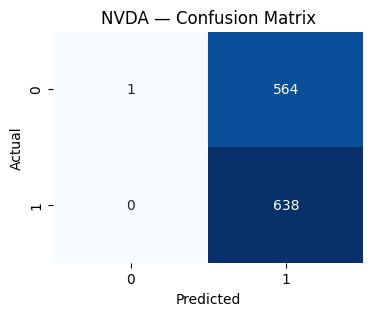


📊 NVDA Results:
   Linear RMSE: 4.7903
   Logistic Accuracy: 0.5312
   R²: 0.9984
   MAE: 1.2802

Confusion Matrix:
[[353 811]
 [450 935]]

Classification Report:
              precision    recall  f1-score   support

           0      0.440     0.303     0.359      1164
           1      0.536     0.675     0.597      1385

    accuracy                          0.505      2549
   macro avg      0.488     0.489     0.478      2549
weighted avg      0.492     0.505     0.488      2549



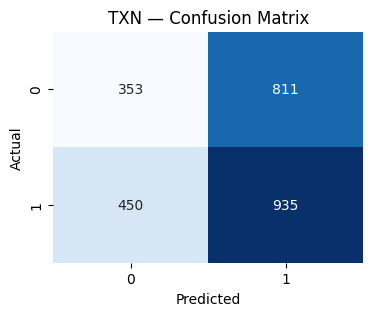


📊 TXN Results:
   Linear RMSE: 2.0273
   Logistic Accuracy: 0.5053
   R²: 0.9953
   MAE: 1.8760

Confusion Matrix:
[[ 22 554]
 [ 23 563]]

Classification Report:
              precision    recall  f1-score   support

           0      0.489     0.038     0.071       576
           1      0.504     0.961     0.661       586

    accuracy                          0.503      1162
   macro avg      0.496     0.499     0.366      1162
weighted avg      0.497     0.503     0.369      1162



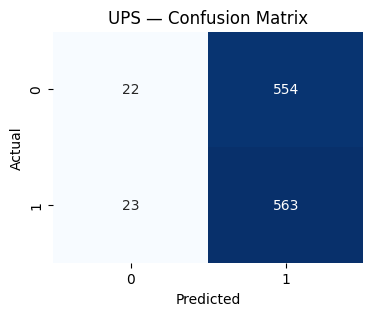


📊 UPS Results:
   Linear RMSE: 2.8272
   Logistic Accuracy: 0.5034

✅ Regression Summary Table:


,Ticker,Rows,Linear_RMSE,Linear_R2,Linear_MAE,Logistic_Accuracy
0,AAPL,10588,1.7229,0.9987,0.9937,0.5250
1,AMD,10776,1.8558,0.9977,0.9653,0.4847
2,CSCO,8267,0.7426,0.9925,0.4938,0.4885
3,EMR,12742,1.0814,0.9940,0.7505,0.5151
4,GE,13354,2.2214,0.9987,1.5980,0.5167
5,HON,13354,2.0475,0.9982,1.2956,0.5316
6,IBM,13354,2.0199,0.9928,1.3902,0.5077
7,MSFT,9262,3.2324,0.9986,1.9492,0.4641
8,NVDA,6011,4.7903,0.9958,2.9560,0.5312
9,TXN,12742,2.0273,0.9984,1.2802,0.5053


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



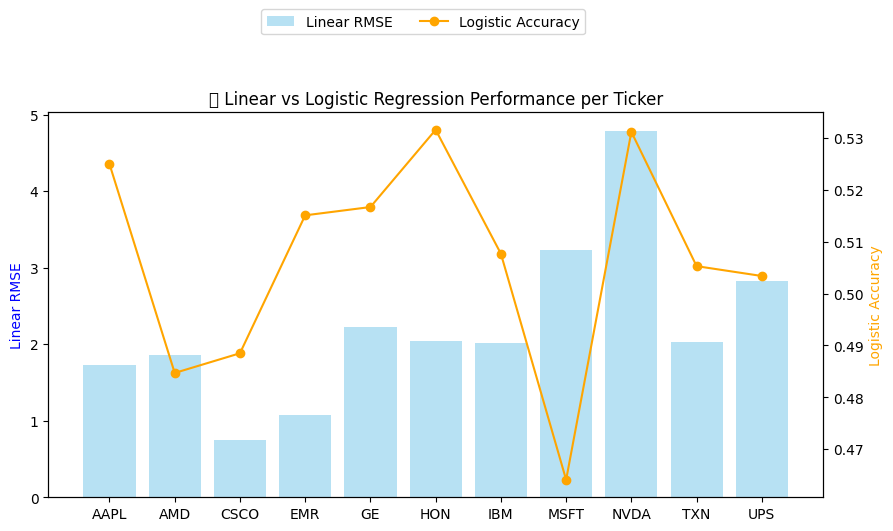

In [22]:
# ==========================================
# ✅ Linear and Logistic Regression on all tickers in 'data'
# ==========================================
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, accuracy_score, classification_report, confusion_matrix

# ------------------------------------------
# 1️⃣ Clean ticker names (remove '(2)' etc.)
# ------------------------------------------
data["Ticker"] = data["Ticker"].str.replace(r"\s*\(.*\)", "", regex=True).str.strip()

# ------------------------------------------
# 2️⃣ Prepare results storage
# ------------------------------------------
results = []

# ------------------------------------------
# 3️⃣ Loop through each ticker
# ------------------------------------------
for ticker in sorted(data["Ticker"].unique()):
    sub = data[data["Ticker"] == ticker].copy()

    # Skip empty or invalid tickers
    if sub.empty:
        continue

    # Create lag features
    sub["Lag1"] = sub["Close"].shift(1)
    sub["Lag2"] = sub["Close"].shift(2)
    sub["Return"] = sub["Close"].pct_change()
    sub["Target"] = (sub["Return"].shift(-1) > 0).astype(int)

    sub = sub.dropna(subset=["Lag1","Lag2","Close","Return","Target"])

    # Skip small datasets
    if len(sub) < 20:
        print(f"⚠️ Skipping {ticker} (not enough data: {len(sub)} rows)")
        continue

    # Split data for Linear Regression
    X_lin = sub[["Lag1", "Lag2"]]
    y_lin = sub["Close"]
    X_train_lin, X_test_lin, y_train_lin, y_test_lin = train_test_split(X_lin, y_lin, shuffle=False, test_size=0.2)

    # Fit linear regression
    linreg = LinearRegression()
    linreg.fit(X_train_lin, y_train_lin)
    y_pred_lin = linreg.predict(X_test_lin)
    rmse = np.sqrt(mean_squared_error(y_test_lin, y_pred_lin))

    from sklearn.metrics import r2_score, mean_absolute_error

    r2 = r2_score(y_test_lin, y_pred_lin)
    mae = mean_absolute_error(y_test_lin, y_pred_lin)
    print(f"   R²: {r2:.4f}")
    print(f"   MAE: {mae:.4f}")


    # Split + scale for Logistic Regression
    X_log = sub[["Lag1", "Lag2", "Return"]]
    y_log = sub["Target"]
    X_train_log, X_test_log, y_train_log, y_test_log = train_test_split(X_log, y_log, shuffle=False, test_size=0.2)

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_log)
    X_test_scaled = scaler.transform(X_test_log)

    logreg = LogisticRegression(max_iter=1000)
    logreg.fit(X_train_scaled, y_train_log)
    y_pred_log = logreg.predict(X_test_scaled)

    acc = accuracy_score(y_test_log, y_pred_log)

    from sklearn.metrics import classification_report, confusion_matrix

    cm = confusion_matrix(y_test_log, y_pred_log)
    print("\nConfusion Matrix:")
    print(cm)

    print("\nClassification Report:")
    print(classification_report(y_test_log, y_pred_log, digits=3))

    # Optional: heatmap visualization
    plt.figure(figsize=(4,3))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title(f"{ticker} — Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()


    # Store results
    results.append({
        "Ticker": ticker,
        "Rows": len(sub),
        "Linear_RMSE": round(rmse, 4),
        "Linear_R2": round(r2, 4),
        "Linear_MAE": round(mae, 4),
        "Logistic_Accuracy": round(acc, 4)
    })

    # Optional: print intermediate summaries
    print(f"\n📊 {ticker} Results:")
    print(f"   Linear RMSE: {rmse:.4f}")
    print(f"   Logistic Accuracy: {acc:.4f}")

# ------------------------------------------
# 4️⃣ Create results summary table
# ------------------------------------------
results_df = pd.DataFrame(results)
print("\n✅ Regression Summary Table:")
display(results_df)

# ------------------------------------------
# 5️⃣ Visualize comparison
# ------------------------------------------
fig, ax1 = plt.subplots(figsize=(10,5))
ax1.bar(results_df["Ticker"], results_df["Linear_RMSE"], alpha=0.6, label="Linear RMSE", color="skyblue")
ax1.set_ylabel("Linear RMSE", color="blue")

ax2 = ax1.twinx()
ax2.plot(results_df["Ticker"], results_df["Logistic_Accuracy"], color="orange", marker="o", label="Logistic Accuracy")
ax2.set_ylabel("Logistic Accuracy", color="orange")

plt.title("📈 Linear vs Logistic Regression Performance per Ticker")
fig.legend(loc="upper center", bbox_to_anchor=(0.5, 1.1), ncol=2)
plt.show()



🔹 AAPL AUC: 0.490


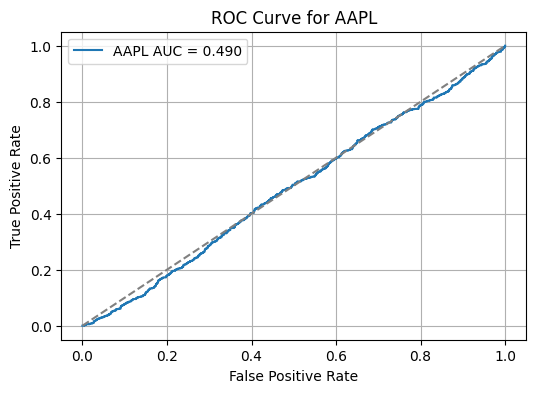


🔹 AMD AUC: 0.489


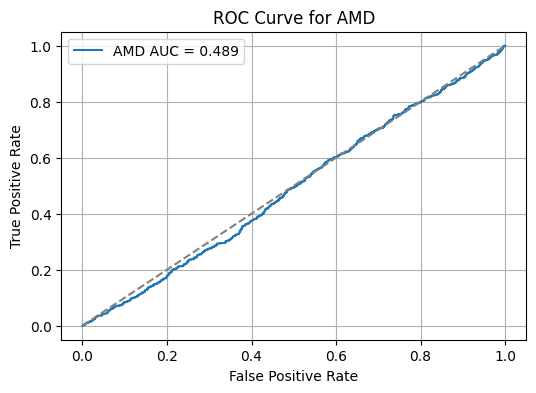


🔹 CSCO AUC: 0.514


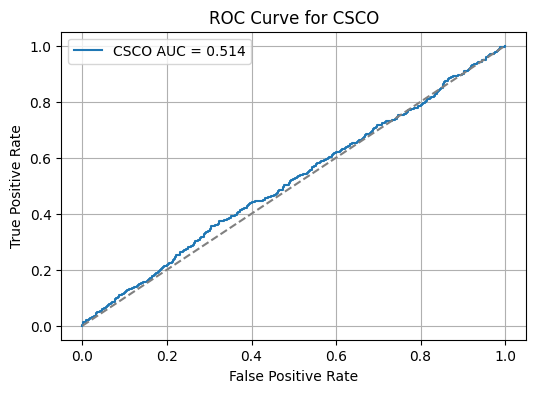


🔹 EMR AUC: 0.487


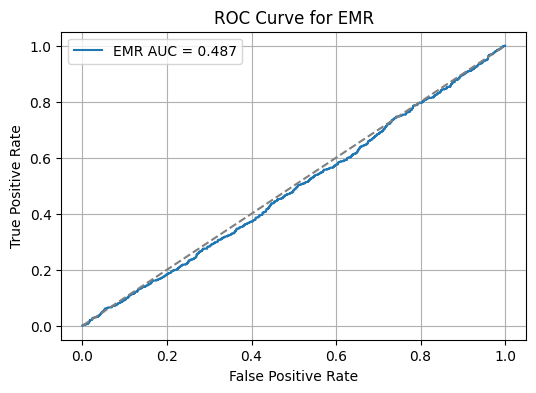


🔹 GE AUC: 0.492


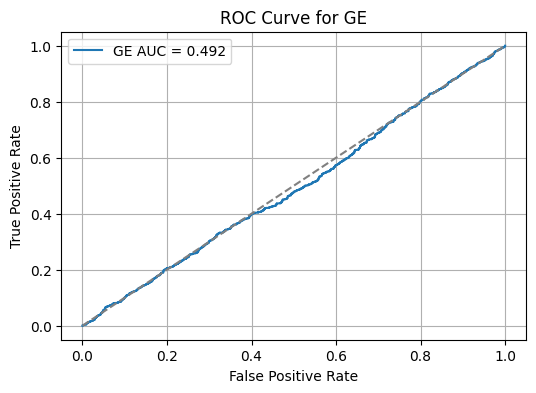


🔹 HON AUC: 0.507


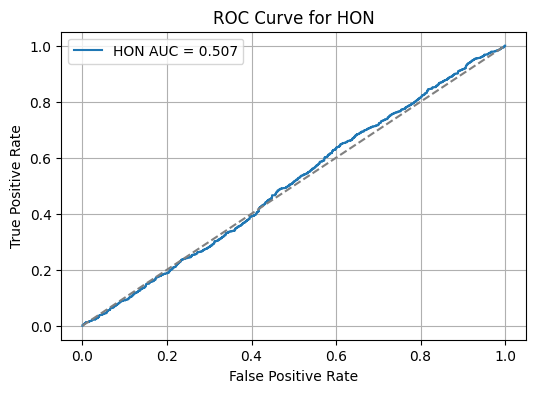


🔹 IBM AUC: 0.485


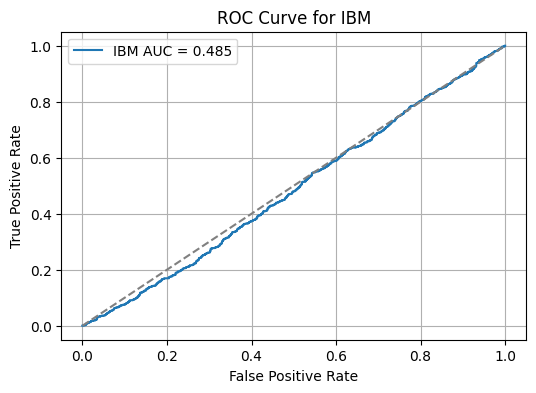


🔹 MSFT AUC: 0.523


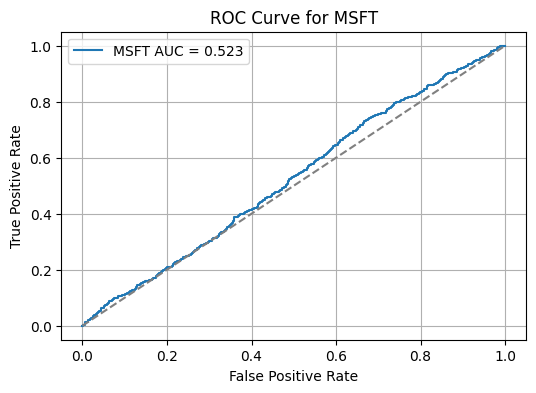


🔹 NVDA AUC: 0.491


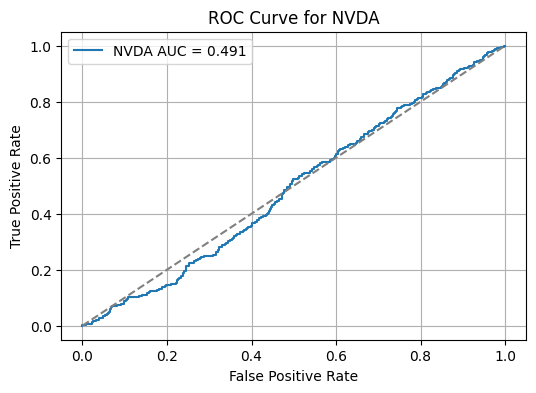


🔹 TXN AUC: 0.477


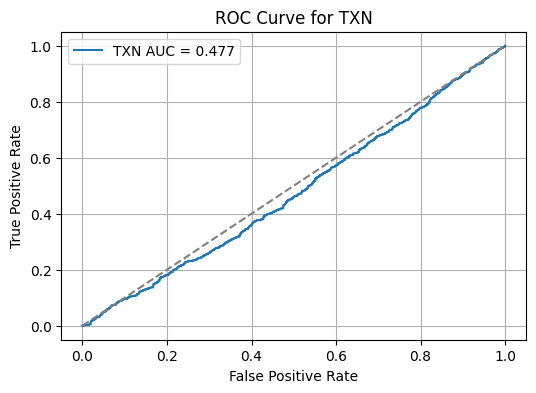


🔹 UPS AUC: 0.490


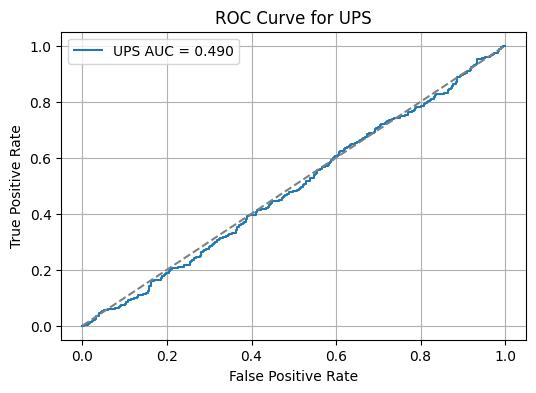

In [23]:
from sklearn.metrics import roc_curve, roc_auc_score

for ticker in sorted(data["Ticker"].unique()):
    sub = data[data["Ticker"] == ticker].copy()
    sub["Lag1"] = sub["Close"].shift(1)
    sub["Lag2"] = sub["Close"].shift(2)
    sub["Return"] = sub["Close"].pct_change()
    sub["Target"] = (sub["Return"].shift(-1) > 0).astype(int)
    sub = sub.dropna(subset=["Lag1", "Lag2", "Return", "Target"])

    # Skip if too few rows
    if len(sub) < 20:
        continue

    # --- Features and target ---
    X = sub[["Lag1", "Lag2", "Return"]]
    y = sub["Target"]

    # --- Train/test split and scaling ---
    X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False, test_size=0.2)
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # --- Logistic Regression ---
    logreg = LogisticRegression(max_iter=1000)
    logreg.fit(X_train_scaled, y_train)

    # --- ROC / AUC ---
    y_prob = logreg.predict_proba(X_test_scaled)[:, 1]
    auc = roc_auc_score(y_test, y_prob)
    fpr, tpr, _ = roc_curve(y_test, y_prob)

    # --- Save AUC into your results_df ---
    results_df.loc[results_df["Ticker"] == ticker, "Logistic_AUC"] = round(auc, 4)

    # --- Print and Plot ---
    print(f"\n🔹 {ticker} AUC: {auc:.3f}")

    plt.figure(figsize=(6,4))
    plt.plot(fpr, tpr, label=f"{ticker} AUC = {auc:.3f}")
    plt.plot([0,1],[0,1],'--',color='gray')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title(f"ROC Curve for {ticker}")
    plt.legend()
    plt.grid(True)
    plt.show()


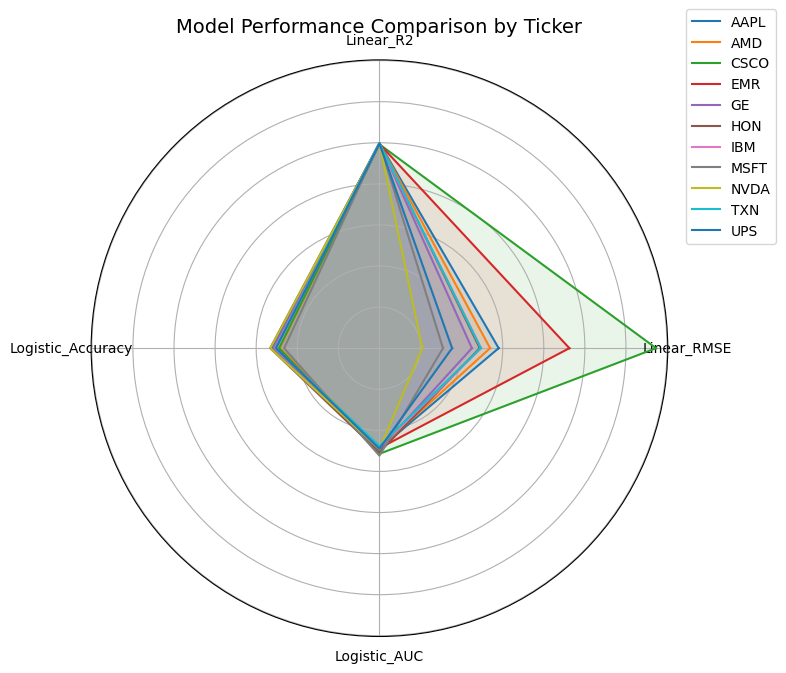

In [24]:
import matplotlib.pyplot as plt
import numpy as np

# --- Normalize metrics for comparison ---
# We invert RMSE since lower is better (so high = good for all metrics)
df = results_df.copy()
df["Linear_RMSE"] = 1 / df["Linear_RMSE"]

# Select metrics to plot
metrics = ["Linear_RMSE", "Linear_R2", "Logistic_Accuracy", "Logistic_AUC"]
num_vars = len(metrics)

# Compute angles for the spider chart
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # complete the loop

# --- Create Spider Chart ---
plt.figure(figsize=(8, 8))
ax = plt.subplot(111, polar=True)

for i, row in df.iterrows():
    values = row[metrics].tolist()
    values += values[:1]  # close the loop
    ax.plot(angles, values, linewidth=1.5, label=row["Ticker"])
    ax.fill(angles, values, alpha=0.1)

# Format chart
ax.set_xticks(angles[:-1])
ax.set_xticklabels(metrics, fontsize=10)
ax.set_yticklabels([])
plt.title("Model Performance Comparison by Ticker", size=14, pad=20)
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1.1))
plt.tight_layout()
plt.show()
